In [7]:
import torch
import torch.nn.functional as F
from FNO.lploss import LpLoss
from FNO.fno_2d_time import FNO2DTime

import numpy as np
import matplotlib.pyplot as plt
import time
from itertools import islice as take
from tqdm import trange

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib import rc

# IPython for displaying the animation
from IPython.display import HTML
rc('animation', html='jshtml')

# Set device for computations
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [2]:
# Load data
data = np.load("data/data.npy")
size_x, size_y, size_t, num_examples = data.shape
data = np.moveaxis(data, -1, 0)
data.shape

(500, 64, 64, 20)

In [3]:
# Split data into train and test
n_train = int(data.shape[0]*0.8)
n_test = data.shape[0] - n_train

# Train data
train_a = torch.tensor(data[:n_train, :, :, :10], dtype=torch.float)
train_u = torch.tensor(data[:n_train, :, :, 10:], dtype=torch.float)

# Test data
test_a = torch.tensor(data[n_train:-10, :, :, :10], dtype=torch.float)
test_u = torch.tensor(data[n_train:-10, :, :, 10:], dtype=torch.float)

# Dimensions
_, sx, sy, T_pred = train_a.shape
print(train_a[0].shape)

# Dataloader
batch_size = 10
train_loader = torch.utils.data.DataLoader(torch.utils.data.TensorDataset(train_a, train_u), batch_size=batch_size, shuffle=True)
eval_loader = torch.utils.data.DataLoader(torch.utils.data.TensorDataset(test_a, test_u), batch_size=batch_size, shuffle=True)

torch.Size([64, 64, 10])


In [4]:
# Train epoch
def train_epoch(dataloader, model, optimizer, scheduler, loss_function):
    
    # Train for each batch
    for x, y in dataloader:
        out = model(x.to(device)).view(batch_size, sx, sy, T_pred)
        
        # Compute loss
        mse = F.mse_loss(out.view(batch_size, -1), y.to(device).view(batch_size, -1), reduction='mean')
        l2 = loss_function(out.view(batch_size, -1), y.to(device).view(batch_size, -1))

        # Clear gradients
        optimizer.zero_grad()

        # Backpropagation
        l2.backward() # l2 pérdida relativa

        # Update weights
        optimizer.step()

    scheduler.step()
    model.eval()
    
def eval_epoch(dataloader, model, loss_function, num_batches=None):
    # Freeze model parameters
    with torch.no_grad():
        # Historiales
        losses, mses = [], []
        
        # Evaluates this epoch with num_batches
        test_l2 = 0
        for a, u_true in take(dataloader, num_batches):
            out = model(a.to(device)).view(batch_size, sx, sy, T_pred)
        
            
            # Evaluamos con las funciones de perdida
            test_l2 = loss_function(out.view(1, -1), u_true.to(device).view(1, -1)).item()
            test_mse = F.mse_loss(out.view(1, -1), u_true.to(device).view(1, -1), reduction='mean')
            losses.append(test_l2)
            mses.append(test_mse.cpu())
            
        # Get mean loss and mean mse
        loss = np.mean(losses)
        mse = np.mean(mses)
        
        return loss, mse
    
def train_model(model, train_dataloader, test_dataloader, lr=1e-3, epochs=20, scheduler_step=100, scheduler_gamma=0.05, train_batches=None, test_batches=None):
    # Función de pérdida
    loss_function = LpLoss(size_average=False)
    # loss_function = torch.nn.L1Loss()
    
    # Usamos al optimizador Adam
    # opt = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-4)
    opt = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=1e-4)
    # opt = torch.optim.Adam(model.parameters(), lr=lr)
    
    # Usamos el scheduler StepLR para reducir de manera constante el learning rate después de ciertos pasos
    scheduler = torch.optim.lr_scheduler.StepLR(opt, step_size=scheduler_step, gamma=scheduler_gamma)
    
    # Inicializamos los historiales
    loss_hist, mse_hist = [], []
    
    # Entrenamos
    for epoch in trange(epochs):
        
        # Entrenamos la época
        train_epoch(train_dataloader, model, opt, scheduler, loss_function)

        # Evaluamos la época en entrenamiento
        trn_loss, trn_mse = eval_epoch(train_dataloader, model, loss_function, train_batches)
        
        # Evaluamos la época en prueba
        tst_loss, tst_mse = eval_epoch(test_dataloader, model, loss_function, test_batches)

        # Guardamos historial
        loss_hist.append([trn_loss, tst_loss])
        mse_hist.append([trn_mse, tst_mse])
        
    return loss_hist, mse_hist

In [6]:
model = FNO2DTime(modes=6, width=40).to(device)

In [18]:
# Train model
loss_hist, mse_hist = train_model(model, train_loader, eval_loader, lr=1e-3, epochs=100)

  0%|          | 0/100 [00:00<?, ?it/s]

100%|██████████| 100/100 [20:43<00:00, 12.43s/it]


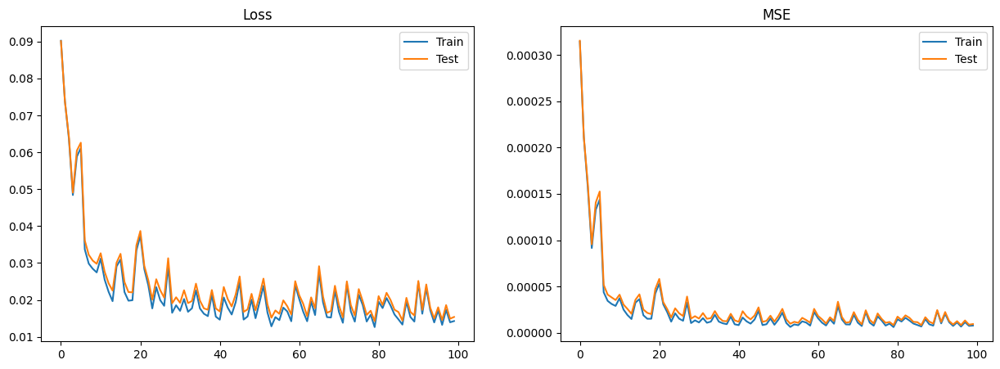

In [19]:
fig,ax = plt.subplots(1, 2, figsize=(15, 5))
ax[0].plot(loss_hist)
ax[0].set_title('Loss')
ax[0].legend(['Train', 'Test'])
ax[1].plot(mse_hist)
ax[1].set_title('MSE')
ax[1].legend(['Train', 'Test'])
plt.show()

In [5]:
model = torch.load('models\FNO2D_HeatEquation_300epochs.pt').to(device)

In [6]:
# Usamos el modelo entrenado para predecir
model.eval()

# Tomamos los datos que no se usaron para entrenar
eval_a , eval_u = torch.tensor(data[-2:-1, :, :, :10], dtype=torch.float), torch.tensor(data[-2:-1, :, :, 10:], dtype=torch.float)
eval_loader = torch.utils.data.DataLoader(torch.utils.data.TensorDataset(eval_a, eval_u), batch_size=1, shuffle=False)
a, u_true = next(iter(eval_loader))

# Predecimos
t0 = time.time()
u_pred = model(a.to(device)).view(1, sx, sy, T_pred)
tf = time.time()

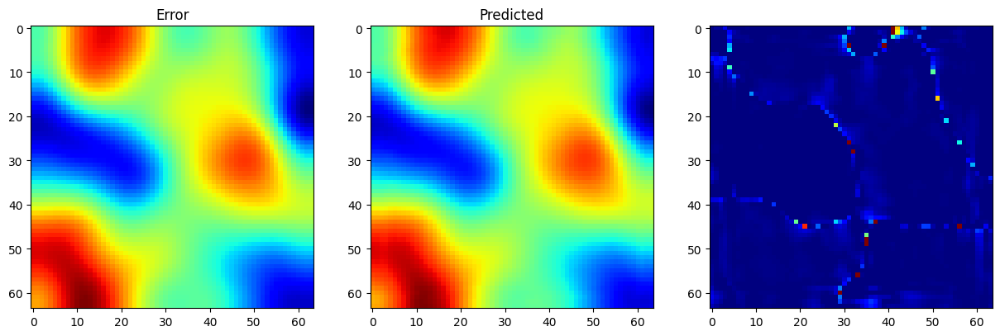

In [10]:
# Creamos una animación
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

def init():
    ax[0].set_title('True')
    ax[1].set_title('Predicted')
    ax[0].set_title('Error')
    return fig,

def animate(i):
    ax[0].imshow(u_true[0, :, :, i].cpu().numpy().T, cmap='jet')
    ax[1].imshow(u_pred[0, :, :, i].cpu().detach().numpy().T, cmap='jet')
    ax[2].imshow(((u_true[0, :, :, i].cpu() - u_pred[0, :, :, i].cpu())/u_true[0, :, :, i].cpu()).detach().numpy().T, cmap='jet', vmin=0, vmax=1)
    return fig,


anim = FuncAnimation(fig, animate, init_func=init, frames=10, interval=200, blit=True)
rc('animation', html='jshtml')
anim

In [12]:
# Make more predictions
results = [u_pred]
new = 200
for i in range(new):
    a = results[-1]
    u_pred = model(a[0:1].to(device)).view(1, sx, sy, T_pred).cpu()
    results.append(u_pred)

MovieWriter ffmpeg unavailable; using Pillow instead.


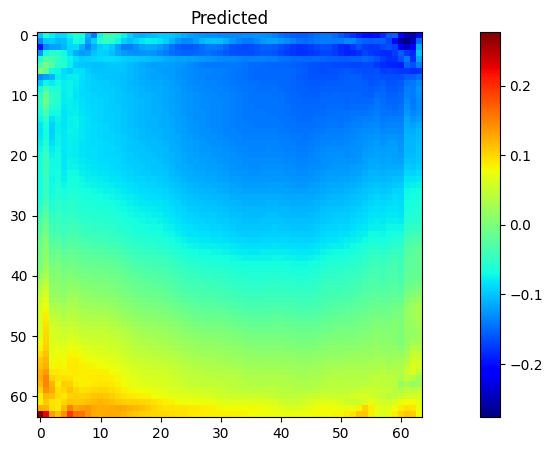

In [15]:
# Make animation
fig, ax = plt.subplots(1, 1, figsize=(15, 5))

# Colorbar
im = ax.imshow(results[0][0, :, :, 0].cpu().detach().numpy().T, cmap='jet')
fig.colorbar(im)

def init():
    ax.set_title('Predicted')
    return fig,

def animate(i):
    ax.imshow(results[i][0, :, :, 0].cpu().detach().numpy().T, cmap='jet')
    return fig,

anim = FuncAnimation(fig, animate, init_func=init, frames=new, interval=200, blit=True)
anim.save('HeatEquation2D_FNO.gif')
rc('animation', html='jshtml')
anim

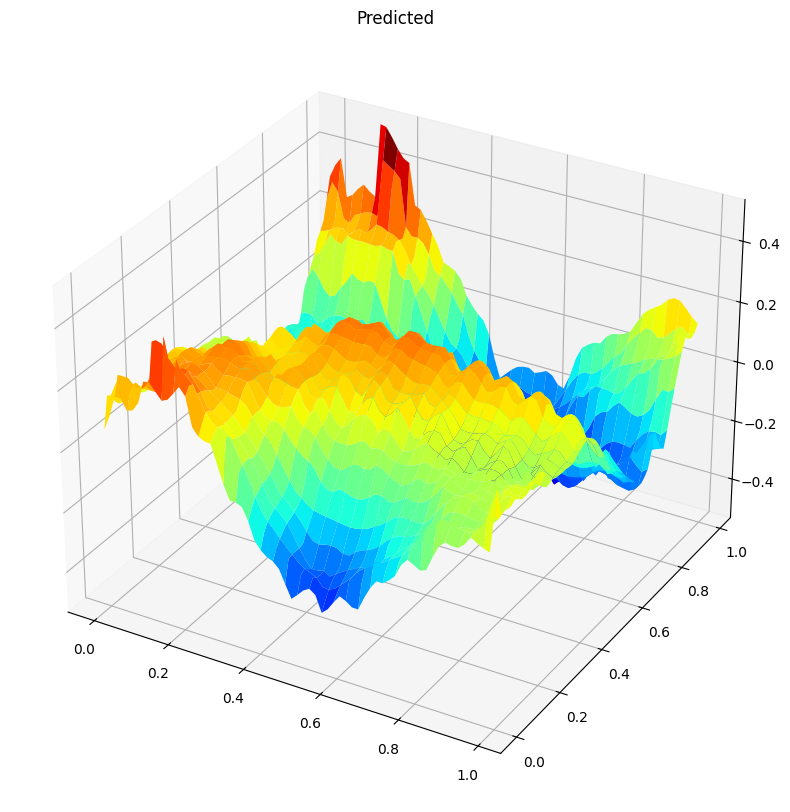

In [37]:
# Make 3D animation
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
X, Y = np.meshgrid(np.arange(0, 1, 1/sx), np.arange(0, 1, 1/sy))
z_min, z_max = results[0][0, :, :, 0].cpu().detach().numpy().min(), results[0][0, :, :, 0].cpu().detach().numpy().max()

def init():
    ax.set_title('Predicted')
    return fig,

def animate(i):
    ax.clear()
    ax.set_title('Predicted')
    ax.plot_surface(X, Y, results[i][0, :, :, 0].cpu().detach().numpy().T, cmap='jet')
    ax.set_zlim(z_min, z_max)
    return fig,

anim = FuncAnimation(fig, animate, init_func=init, frames=50, interval=200, blit=True)
anim.save('HeatEquation2D_FNO_3D.gif')
rc('animation', html='jshtml')
anim